# Homework 4-  Hard coding

![alt text](img/SA_SL_KA.png "")

##### **Authors:** Daniel Jiménez & Bertrand Leclercq & Iman Sayyadzadeh
##### **Date:** 2020/12/23
##### **Subject:** Algorithmic Methods of Data Mining
##### **Data Science Master's programme**
##### **La Sapienza University of Rome**
_____

This file contains the solution to all the three Challenges (and its corresponding literals) required for the Hash and Clustering application regarding the [hast.txt](https://drive.google.com/file/d/19SD2db0dH2A0QLJOmBHnkbqOX6SbERcY/view) and [Amazon Fine Food Reviews](https://www.kaggle.com/snap/amazon-fine-food-reviews) datasets, respectively.

As like in any Analytics application case, it's relevant to keep clean and tidy the working environment. We achieve this by explaining step-by-step the process we followed to apply the hash functions, the algorithm called HyperLogLog and the K-Means Clustering methodology. 

**Notes:** 
- We worked on a PC with an SSD of 50 GB of free space and a RAM of 16 GB.
- To visualize correctly the content of this Notebook we recommend you access to [THIS](https://nbviewer.jupyter.org/github/damjimenezgu/ADM-HW4/blob/main/main.ipynb) page or to download the Notebook in your PC and open it from Anaconda. It is mainly because from GitHub you can't see the plots made with `Plotly express`.

Well, first thing first, we set the libraries that we will be using to perform all hashing and clustering implementation.

In [12]:
# Import required libraries
import pandas as pd
import numpy as np
import time
import missingno as msno 
import plotly.express as px
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from collections import Counter
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
import ast
import re
import itertools
import collections
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
import random
from scipy.spatial import distance as dist
from sklearn.cluster import KMeans
import statsmodels.api as sm
from statsmodels.formula.api import ols
import scipy.stats as stats
import seaborn as sns
from matplotlib import pyplot
import scipy.stats as stats
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import math
import random
from scipy.integrate import quad
from progress.counter import Counter
import our_functions

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Daniel_Jimenez\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Daniel_Jimenez\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Daniel_Jimenez\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


# 1. Hashing

The first thing that we define is to create a hash table that will map each of the letters and digits to a random binary number.

In [ ]:
# Generate a hash table that map the letters and digit to a random binary number.
# Indexes [0-9] are for the corresponding digit and indexes [10-35] are for the letters [A-Z].
numberOfSymbols = 26 + 10
hashTable = [random.randint(0, 1) for _ in range(numberOfSymbols)]


def hash(x):
    '''
    The hash function get the binary number from the hashTable for each character of x.
    '''
    h = ''
    for i in x:
        if i.isdigit():
            h += str(hashTable[int(i)])
        else:
            # We use the ord() function on the uppercase of the letter to get is ascii code.
            # As the ascii code for [A-Z] is [65-90], we substract 55 so it goes to [10-35]
            h += str(hashTable[ord(i.upper()) - 55]) 

    return h

Next step is to define the function that provides us with the position of the leftmost 1-bit.

In [ ]:
def p(s):
    '''
    This function get the position of the leftmost 1-bit.
    '''
    position = 1
    for i in s:
        if i == '1':
            break
        else:
            position += 1

    return position

Finally, the last function that we define is the one used for the count-distinct problem.  It approximates the number of distinct elements in a multiset, and it's called This is the HyperLogLog function.

In [ ]:
def HLL(file, b=11):
    '''
    This is the HyperLogLog function. As parameter, it need the path to the file with the data and the b parameter that specify the desired accuracy
    '''

    # Compute the number of bucket m based on the b parameter
    m = 2**b 

    # Compute the alpha constant using the number of bucket m and the `quad` function to calcul the integral 
    alpha, _ = quad(lambda x : math.log((2+x) / (1+x), 2) ** m, 0, math.inf)
    alpha = (m * alpha) ** -1

    # Initialize the m buckets with a value of -inf
    M = [-math.inf for _ in range(m)]

    # We open the file and read the lines one by one with a while loop
    with open(file, 'r') as file:
        line = file.readline().replace('\n', '')
        while line:
            # Get the hash the line
            x = hash(line)
            # Transform the first b bits of the hash, which is in binary, to a decimal number (it will be the index of the bucket)
            j = int(x[:b], 2)
            # Update the bucket of index j (first b bits of the hash) with the position of the leftmost 1-bit of the rest of the hash
            # if it is bigger that the current value of the bucket
            M[j] = max(M[j], p(x[b:]))

            line = file.readline().replace('\n', '')

    # Compute the cardinality E (Z is the sum part of it, it is seperated for more readability)
    Z = sum(list(map(lambda i: 2 ** -i, M))) ** -1
    E = alpha * m ** 2 * Z
    # Compute the Standart Error of the HLL based on the number of bucket, and thus on the b parameter
    err = 1.04 / math.sqrt(m)
    
    return (E, err)

Now, it is time to apply the function that we created to get the cardinality of the `hash.txt` file

In [ ]:
cardinality, error = HLL('hash.txt')
print(f'The cardinality is {cardinality} with a Standard Error of {error}')

The cardinality is 127191324.47356233 with a Standard Error of 0.022980970388562793


As we can see, the cardinality of the `hash.txt` is 127'191,325, and the obtained error is about 2.30% as expected for this type of methods (HyperLogLog algorithm).

# 2. Clustering

## a. Implement the k-means clustering algorithm

To solve this task, we were encouraged to implement the K-means clustering algorithm. In the next steps, we explain the pseudocode that we used to construct the algorithm:

1. Define k as the number of desired clusters
2. Initialize the centroids by taking k points randomly from the data (and all the features)
3. Compute the distance of each example to all the centroids
4. Assing each example its closest cluster
5. Recompute the new centroids based on the assigned clusters
6. Repeat the steps 3, 4 and 5 until convergence (or to the maximum number of iterations)

If you want to have a closer look at the algorithm that we created, please go to the file **our_functions.py**.

It is relevantto mention that for the sake of the speed of the algorithm, we used an approach leveraged up in calculation in batch (taking the whole data), instead of using loops over each one of the examples. In the end, we got good running time, very close to the actual functions that Python has to execute K-means.

## b. Run the algorithm on the food data.

Now, we proceed to prove our algorithm over the food data. But first, we want to execute an initial exploratory analysis to understand the data that we will work with.

In [2]:
# Read dataset
dataset = pd.read_csv('data/Reviews.csv')

Once our data is loaded, we proceed to obtain some initial summary statistics over the numerical columns of our dataset.

In [3]:
start_time = time.time()
# Change the type of Time to a human readable format
dataset['Time'] = pd.to_datetime(dataset.Time,unit="s")
# Statistics by group
print(dataset[['Id' , 'HelpfulnessNumerator', 'HelpfulnessDenominator', 'Score', 'Time']].describe(include = 'all', datetime_is_numeric = True))
print("--- %s seconds ---" % (time.time() - start_time))

                  Id  HelpfulnessNumerator  HelpfulnessDenominator  \
count  568454.000000         568454.000000            568454.00000   
mean   284227.500000              1.743817                 2.22881   
min         1.000000              0.000000                 0.00000   
25%    142114.250000              0.000000                 0.00000   
50%    284227.500000              0.000000                 1.00000   
75%    426340.750000              2.000000                 2.00000   
max    568454.000000            866.000000               923.00000   
std    164098.679298              7.636513                 8.28974   

               Score                           Time  
count  568454.000000                         568454  
mean        4.183199  2011-01-28 23:16:44.902419712  
min         1.000000            1999-10-08 00:00:00  
25%         4.000000            2010-04-15 00:00:00  
50%         5.000000            2011-07-20 00:00:00  
75%         5.000000            2012-03-26 00

From the previous information, we can extract that:
    
- HelpfulnessNumerator vary from 0 to 866.07. Besides, the mean is 1.74. Finally, HelpfulnessNumerator varies, on average, 7.63 from the mean value.
- HelpfulnessDenominator vary from 0 to 923. Besides, the mean is 2.22 (similar to the previous variable). Finally, HelpfulnessDenominator varies, on average, 8.28 from the mean value.
- Score varies from 1 to 5. Besides, the mean score is 4.1 (many of them are quite good reviews). Finally, the score varies, on average, 1.31 from the mean value.
- The dates of the reviews go from 8th October 1999 to 26th October 2012
- Id, although it is numerical, the interpretation of its mean, deviation or quartiles does not make much sense to be interpreted.

Now, we check some initial frequences on the non-numerical variables:

In [5]:
start_time = time.time()
print("Frequences for ProductId:\n", dataset.ProductId.value_counts(), "\n")
print("Frequences for UserId:\n", dataset.UserId.value_counts(), "\n")
print("Frequences for ProfileName:\n", dataset.ProfileName.value_counts(), "\n")
print("Frequences for Summary:\n", dataset.Summary.value_counts())
# print("Frequences for Text:\n", dataset.Text.value_counts())
print("Frequences for Time:\n", dataset.Time.dt.to_period('M').value_counts())
print("--- %s seconds ---" % (time.time() - start_time))

Frequences for ProductId:
 B007JFMH8M    913
B0026RQTGE    632
B002QWP89S    632
B002QWP8H0    632
B002QWHJOU    632
             ... 
B0022N2I26      1
B000GB3LRM      1
B002FWUEYS      1
B001EO61BI      1
B000SSQXG4      1
Name: ProductId, Length: 74258, dtype: int64 

Frequences for UserId:
 A3OXHLG6DIBRW8    448
A1YUL9PCJR3JTY    421
AY12DBB0U420B     389
A281NPSIMI1C2R    365
A1Z54EM24Y40LL    256
                 ... 
A2JR6WQJW269FW      1
A3QRKCU5CRAM1Z      1
A2ANEQEX9FU7TK      1
A1GRHU31P7Z5BA      1
AA9EEFS4856         1
Name: UserId, Length: 256059, dtype: int64 

Frequences for ProfileName:
 C. F. Hill "CFH"                          451
O. Brown "Ms. O. Khannah-Brown"           421
Gary Peterson                             389
Rebecca of Amazon "The Rebecca Review"    365
Chris                                     363
                                         ... 
J. "JBW"                                    1
David Moldauer                              1
kjfoster            

From above we conclude that:
- The productId that has the highest number of reviews is B007JFMH8M. On the other hand, B001W9L2GE and many other products only have one review.
- The two most common ProfileName are C. F. Hill "CFH" and O. Brown "Ms O. Khannah-Brown".
- Plenty of the summaries are related to Delicious, Yummy and Great product.
- There are 21,912 reviews from 2012-09 (the month with the higher number of reviews) and 21,686 events from 2012-01. There are a few reviews from the years 2001-2002.

As a relevant activity, it's always important to check how much missing data we are dealing with. We do it by creating a barplot of the missing values per attribute.

<AxesSubplot:>

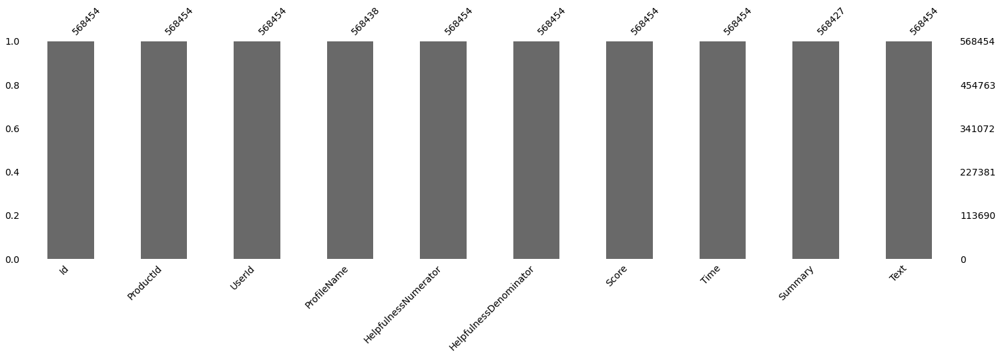

In [6]:
msno.bar(dataset, labels=True, figsize=(25,6), fontsize=14)

The previous chart shows the number of non-missing values in each of the variables. As we can see, most of the variables are complete. The only two variables that are not complete are *ProfileName* and *Summary*. So far we do not remove or impute those missing values, because we don't think that for this exercises we have to do so.

In [8]:
start_time = time.time()
print("Number of rows after deleting duplicates")

print(dataset.drop_duplicates(subset = ['ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator',
       'HelpfulnessDenominator', 'Score', 'Time', 'Summary', 'Text'], keep = 'first').shape[0])
print("--- %s seconds ---" % (time.time() - start_time))

Number of rows after deleting duplicates
568173
--- 1.6089298725128174 seconds ---


As we can see, there are 281 duplicated rows. Then, we will delete those duplicates to have only reviews that are distinct among them.

In [9]:
dataset = dataset.drop_duplicates(subset = ['ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator',
       'HelpfulnessDenominator', 'Score', 'Time', 'Summary', 'Text'], keep = 'first')

Now we would like to dig a bit deeper in the field *text* of the review to have initial statistics about what that field represents. To do so, we calculate the length of each review to create a histogram of that length.

In [10]:
# Get number of words
dataset['words_text'] = dataset['Text'].str.split().fillna(0).apply(len)

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


count    568173.000000
mean         80.223029
std          79.326831
min           3.000000
25%          33.000000
50%          56.000000
75%          98.000000
max        3432.000000
Name: words_text, dtype: float64


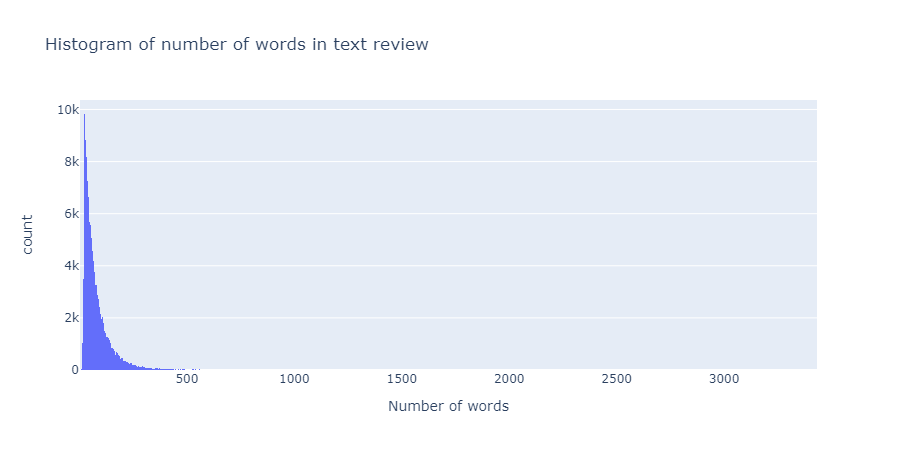

In [12]:
# Get statistics from the number of words
print(dataset.words_text.describe())

# Plot histogram for number of words
fig = px.histogram(dataset, x="words_text", title='Histogram of number of words in text review', labels={'words_text':'Number of words'})
fig.show()

As we can see, the reviews have 80 words on average, having reviews with only 3 and up to 3,432 words. The coefficient of variation of the number of words is close to 100%, meaning that the length of the reviews is very volatile. The majority of the comments (almost 10,000) have 23 words. Besides, 75% of the commentaries have less than 100 words. As an important fact, there are no empty texts, meaning that all the reviews have some information use.

Finally, we will keep only the columns that we are interested in to analize.

In [3]:
# Keep desired columns
dataset_reduced = dataset[['ProductId','UserId','Score','Text']]

Now we are ready to preprocess the text of the reviews. So, for each review we will:

1. Remove stopwords
2. Remove punctuation
3. Convert to lowercase
4. 'Manually' stem common irregular verbs (regular stemmers do not consider irregular verbs, so we have downoaded a table of irregular verbs, and did the stemming 'manually')
5. Stemming for regular verbs
6. Removing stemmed words that have length less or equal to 2 (e.g., single letters)

In [4]:
start_time = time.time()
# Application and examples
dataset_reduced['Text_prep'] = dataset_reduced['Text'].apply(our_functions.tokenize_row)
print(dataset_reduced['Text_prep'][0])

# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod.csv', index = False, sep="|")
print("--- %s seconds ---" % (time.time() - start_time))

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


['I', 'have', 'bought', 'several', 'of', 'the', 'Vitality', 'canned', 'dog', 'food', 'products', 'and', 'have', 'found', 'them', 'all', 'to', 'be', 'of', 'good', 'quality', 'The', 'product', 'looks', 'more', 'like', 'a', 'stew', 'than', 'a', 'processed', 'meat', 'and', 'it', 'smells', 'better', 'My', 'Labrador', 'is', 'finicky', 'and', 'she', 'appreciates', 'this', 'product', 'better', 'than', 'most']
--- 533.8897159099579 seconds ---


In [5]:
start_time = time.time()

dataset_reduced['Text_prep'] = dataset_reduced['Text_prep'].apply(our_functions.rm_stopwords_row)
print(dataset_reduced['Text_prep'][0])

# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod.csv', index = False, sep="|")

print("--- %s seconds ---" % (time.time() - start_time))

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


['bought', 'several', 'vitality', 'canned', 'dog', 'food', 'products', 'found', 'good', 'quality', 'product', 'looks', 'like', 'stew', 'processed', 'meat', 'smells', 'better', 'labrador', 'finicky', 'appreciates', 'product', 'better']
--- 30.441644191741943 seconds ---


In [6]:
start_time = time.time()
dataset_reduced['Text_prep'] = dataset_reduced['Text_prep'].apply(our_functions.irregular_verbs)
print(dataset_reduced['Text_prep'][0])

# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod.csv', index = False, sep="|")

print("--- %s seconds ---" % (time.time() - start_time))

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


['buy', 'several', 'vitality', 'canned', 'dog', 'food', 'products', 'find', 'good', 'quality', 'product', 'looks', 'like', 'stew', 'processed', 'meat', 'smells', 'better', 'labrador', 'finicky', 'appreciates', 'product', 'better']
--- 1962.5102880001068 seconds ---


In [7]:
start_time = time.time()

dataset_reduced['Text_prep'] = dataset_reduced['Text_prep'].apply(our_functions.stem_row)
print(dataset_reduced['Text_prep'][0])

# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod.csv', index = False, sep="|")

print("--- %s seconds ---" % (time.time() - start_time))

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


['buy', 'several', 'vitality', 'canned', 'dog', 'food', 'products', 'find', 'good', 'quality', 'product', 'looks', 'like', 'stew', 'processed', 'meat', 'smells', 'better', 'labrador', 'finicky', 'appreciates', 'product', 'better']
--- 29.316829442977905 seconds ---


In [8]:
start_time = time.time()

dataset_reduced['Text_prep'] = dataset_reduced['Text_prep'].apply(our_functions.rm_stopwords_row)
print(dataset_reduced['Text_prep'][0])

# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod.csv', index = False, sep="|")

print("--- %s seconds ---" % (time.time() - start_time))

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


['buy', 'several', 'vitality', 'canned', 'dog', 'food', 'products', 'find', 'good', 'quality', 'product', 'looks', 'like', 'stew', 'processed', 'meat', 'smells', 'better', 'labrador', 'finicky', 'appreciates', 'product', 'better']
--- 25.79172444343567 seconds ---


Here we established a checkpoint since due to the execution time and complexity, our PC crashed and was necessary to upload the last data set with the preprocessed reviews.

In [2]:
# Read dataset
dataset_reduced = pd.read_csv('data/reviews_mod.csv', sep ="|")

# Transform the preprocessed  text to a list in each row
dataset_reduced.Text_prep = dataset_reduced.Text_prep.apply(ast.literal_eval)

Once the previous preprocessing has finished, we want to check how the new variable with the text review looks like, at least in terms of the distribution of the number of words.

In [3]:
# Get number of words
dataset_reduced['words_text'] = dataset_reduced['Text_prep'].fillna(0).apply(len)

count    568454.000000
mean         37.860891
std          37.896935
min           0.000000
25%          16.000000
50%          26.000000
75%          46.000000
max        1846.000000
Name: words_text, dtype: float64

Number of reviews with 0 words after preprocessing 8


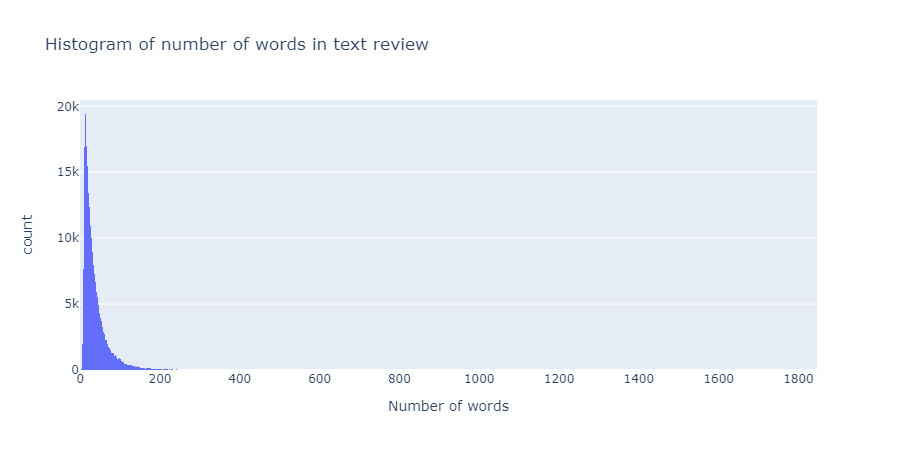

In [4]:
# Get statistics from the number of words
print(dataset_reduced.words_text.describe())

# Get number of reviews with 0 words after preprocessing
print("\nNumber of reviews with 0 words after preprocessing", dataset_reduced[dataset_reduced.words_text == 0].shape[0])

# Plot histogram for number of words
fig = px.histogram(dataset_reduced, x="words_text", title='Histogram of number of words in text review', labels={'words_text':'Number of words'})
fig.show()

Now, with the preprocessed text, the reviews have 37 words on average, having reviews with 0 and up to 1,846 words. This time, the majority of the comments (almost 19,400) have 13 words. Besides, 75% of the commentaries have less than 46 words. In this opportunity, 8 reviews are empty, meaning that we will discard that 8 comments since they don't provide any information (and besides they are not that many). The previous operation left us with 568,446 reviews.

In [4]:
# Delete the reviews with 0 words
dataset_reduced = dataset_reduced[dataset_reduced.words_text > 0]

In [5]:
start_time = time.time()
# Create the tokens from the preprocessed text
tokens = list(itertools.chain(*dataset_reduced.Text_prep))

# Get the frequency of words
counts_words = collections.Counter(tokens)

# Convert frequencies to dataframe to plot them
words_freq = pd.DataFrame(counts_words.most_common(len(counts_words)),columns=['words', 'count'])
print("--- %s seconds ---" % (time.time() - start_time))

--- 5.956830263137817 seconds ---


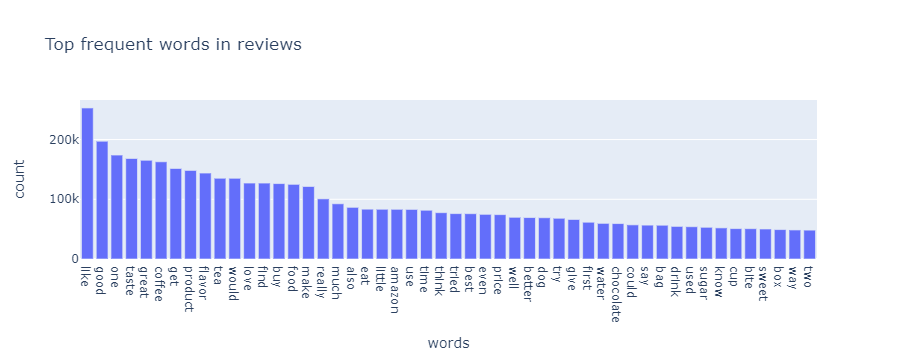

In [7]:
# Plot top 50 most frequent words
fig = px.bar(words_freq.head(50), x='words', y='count', width=900, height=300,  title="Top frequent words in reviews")
fig.show()

From the previous chart, we can find words that appear in many of the reviews that are: **Like, taste, flavour, good, product**. Those words are related to the appealing of the food that Amazon sells. They were expected to be found in the positions of the first. The previous since they are usual to find in any type of comment about the food. Besides, we can find products like **tea, coffee, hot dog, drinks, water or chocolate**, regarding the most commented products.

Now, we are ready to calculate the features to be used in both Truncated Singular Value Decomposition (SVD) and K-means. To achieve that we decided to represent the data by implementing TF-IDF. In that way, we consider account the relative frequency of the terms that appear in each review and in general. Besides, truncated SVD works on term TF-IDF matrices.  The previous is known as latent semantic analysis (LSA).

In [12]:
start_time = time.time()

reviews = [' '.join(map(str, l)) for l in dataset_reduced['Text_prep']]

vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(reviews)
print("Shape of sparse matrix", print(X.shape))
print("--- %s seconds ---" % (time.time() - start_time))

(568446, 102358)
Shape of sparse matrix None
--- 27.858304023742676 seconds ---


With the previous vectorizer, we manage to create the *X* matrix that contains 568,446 rows and 102,358 columns. Those values correspond to the number of reviews that we are analyzing and the total number of different words existing in the reviews after the preprocessing step, respectively.

Now, we apply the SVD to the sparse data generated. In this case, we implemented a loop to check where we retain at least 60% of the variance. That process is used to find a threshold between reducing the number of variables to be used and maintaining the major part of the useful information.

In [9]:
start_time = time.time()

# Define the model of SVD
svd = TruncatedSVD(n_components=1400, random_state=0)
# Fit the model of SVD to our data
svd.fit(X)
# Retrieve the cumulated explained variance ratio across the components taken
explained_var = np.cumsum(svd.explained_variance_ratio_)

print("The  the total amount of variance is:", explained_var[-1])
print("--- %s seconds ---" % (time.time() - start_time))

The  the total amount of variance is: 0.6080599165016258
--- 5322.592506408691 seconds ---


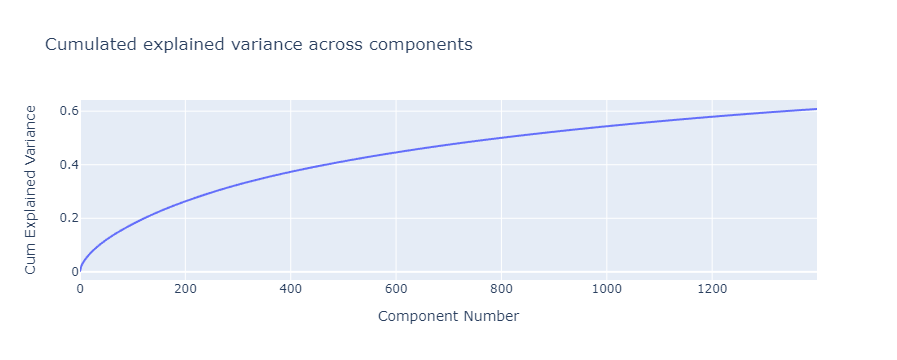

In [10]:
# Convert frequencies to dataframe to plot them
explained_var = pd.DataFrame(explained_var,columns=['cum_var_ratio'])
# Plot the cumulated explained variance
fig = px.line(explained_var, x=explained_var.index, y='cum_var_ratio', width=900, height=300,  title="Cumulated explained variance across components", labels={'cum_var_ratio':'Cum Explained Variance','index':'Component Number'})
fig.show()

With the previous line plot, we can define that to retain the *60.7%* of variance from the data we can take the first **1400** components, instead of taking the 102,358 variables that we were dealing with. Then we just need to use the `transform` function to perform dimensionality reduction on X.

In [11]:
start_time = time.time()
# Convert frequencies to dataframe to plot them
X_kmeans = svd.transform(X)
print("--- %s seconds ---" % (time.time() - start_time))

--- 20.283150911331177 seconds ---


In the previous code we created the sparse matrix to be used as data by producing the TF-IDF matrix of terms from the reviews.

Here we established a new checkpoint to be able to load the data that we have been working with until this point. To do so, we saved our X_kmeans matrix as a `paquet` file.

In [12]:
start_time = time.time()
# Export data set to load it in case that any process crashes
X_kmeans_df = pd.DataFrame(X_kmeans)
X_kmeans_df.columns = X_kmeans_df.columns.astype(str)
X_kmeans_df.to_parquet('data/X_kmeans.parquet')
print("--- %s seconds ---" % (time.time() - start_time))

--- 125.69706201553345 seconds ---


In [2]:
start_time = time.time()
# Load data from parquet file
X_kmeans = pd.read_parquet("data/X_kmeans.parquet").to_numpy()
print("--- %s seconds ---" % (time.time() - start_time))

--- 30.0452299118042 seconds ---


## 2. Run the algorithm on the food data

Now, to find the optimal number of clusters that we should use, we will use the Elbow Method. It is, running our K-means varying the number of the cluster from 2 to 30. In each iteration, we retrieve the inertia. Finally, we determine the optimal number of clusters when the inertia starts to have small changes from one iteration to the next.

In [16]:
start_time = time.time()

# loop over range of possible number of clusters
inertias_k_times = []
for i in range(2,30):
    partial_time1 = time.time()
    # Call our kmeans function
    cluster, inertia = our_functions.our_kmeans(X_kmeans, i)
    # Append the inertia from each iteration
    inertias_k_times.append(inertia)
    
    # Save inertias to recover if computer crashes
    inertias_k_times_df = pd.DataFrame(inertias_k_times)
    inertias_k_times_df.columns = inertias_k_times_df.columns.astype(str)
    pd.DataFrame(inertias_k_times_df).to_parquet('data/inertias_k_times.parquet')
    
    print("Processing cluster", i, "/ 30 took", time.time() - partial_time1, "seconds")
    print("Inertia", i, ":", inertia)
print("--- %s seconds ---" % (time.time() - start_time))

Processing cluster 2 / 30 took 307.66397881507874 seconds
Inertia 2 : [336171.25269948]
Processing cluster 3 / 30 took 342.2145550251007 seconds
Inertia 3 : [332683.17875572]
Processing cluster 4 / 30 took 596.0741894245148 seconds
Inertia 4 : [330397.23622129]
Processing cluster 5 / 30 took 665.2404336929321 seconds
Inertia 5 : [329837.04107627]
Processing cluster 6 / 30 took 678.1744432449341 seconds
Inertia 6 : [329106.02934898]
Processing cluster 7 / 30 took 1480.0722825527191 seconds
Inertia 7 : [327819.75246634]
Processing cluster 8 / 30 took 824.5787124633789 seconds
Inertia 8 : [326503.70036019]
Processing cluster 9 / 30 took 1057.8533148765564 seconds
Inertia 9 : [326122.69829914]
Processing cluster 10 / 30 took 2793.417801618576 seconds
Inertia 10 : [324865.78713317]
Processing cluster 11 / 30 took 2503.2049157619476 seconds
Inertia 11 : [323718.12342368]
Processing cluster 12 / 30 took 2475.1600670814514 seconds
Inertia 12 : [323092.47437604]
Processing cluster 13 / 30 took 

In [14]:
start_time = time.time()
# Load data from parquet file
inertias_k_times = pd.read_parquet("data/inertias_k_times.parquet")
print("--- %s seconds ---" % (time.time() - start_time))

--- 0.026887893676757812 seconds ---


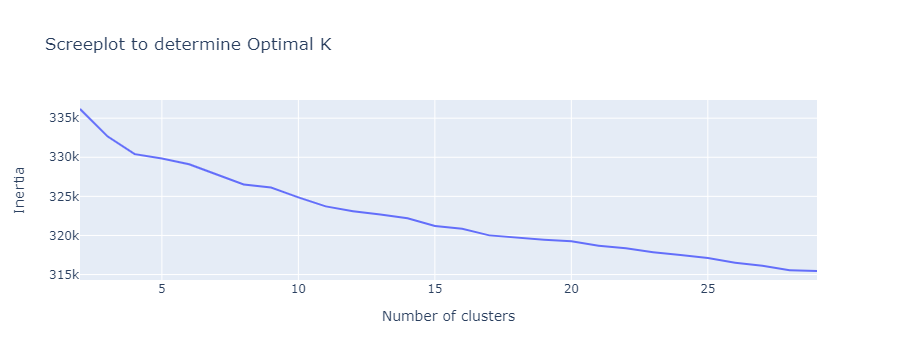

In [19]:
# Convert frequencies to dataframe to plot them
inertias_k_times = pd.DataFrame(inertias_k_times,columns=['inertia'])
# Plot inertias
fig = px.line(inertias_k_times, x=inertias_k_times.index + 2, y='inertia', width=500, height=300,  title="Screeplot to determine Optimal K ", labels={'inertia':'Inertia','x':'Number of clusters'})
fig.show()

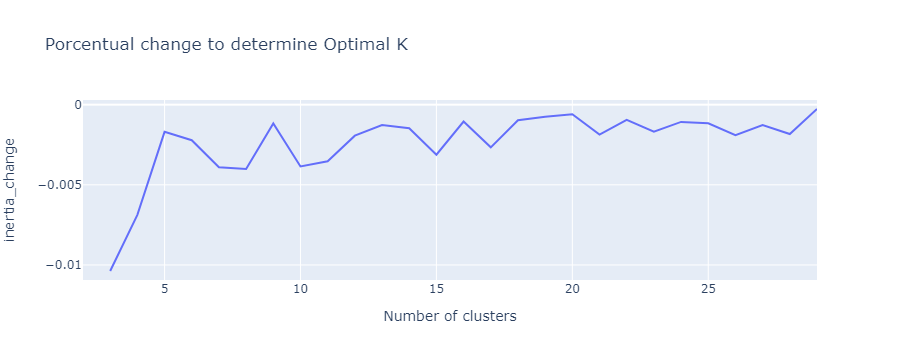

In [91]:
inertias_k_times['inertia_change'] = inertias_k_times.inertia / inertias_k_times.inertia.shift(periods=1) - 1

# Plot inertias
fig = px.line(inertias_k_times, x=inertias_k_times.index + 2, y='inertia_change', width=500, height=300,  title="Porcentual change to determine Optimal K ", labels={'inertia':'Inertia','x':'Number of clusters'})
fig.show()

Based on the previous graph, we can say that the optimal number of clusters should be 20 since it is the point where the porcentual change start to be stable is in that number of clusters.

It is time to run our K-means algorithm again, but this time with the resulting optimal number of clusters.

In [3]:
start_time = time.time()
# Call our k-means with the number of cluster desired
cluster, inertia = our_functions.our_kmeans(X_kmeans, 20)

# Save inertia and clusters to recover if computer crashes
cluster_df = pd.DataFrame(cluster)
cluster_df.columns = cluster_df.columns.astype(str)
pd.DataFrame(cluster_df).to_parquet('data/cluster.parquet')

inertia_df = pd.DataFrame(inertia)
inertia_df.columns = inertia_df.columns.astype(str)
pd.DataFrame(inertia_df).to_parquet('data/inertia.parquet')

print("--- %s seconds ---" % (time.time() - start_time))

--- 3207.107415676117 seconds ---


Now, as we want to compare the performance of our algorithm against the K-means++, we will use the Kmeans function from `sklearn` to execute the former. It is relevant to say that we will use the same number of clusters found in the previous exercise, to make the two approaches comparable.

In [4]:
start_time = time.time()
# Call the k-means++ with the number of cluster desired
kmeans_pp = KMeans(init = "k-means++", n_clusters = 20, max_iter = 300, random_state = 0)
# Fit the k-means++ 
kmeans_pp.fit(X_kmeans)
# Extract inertia
inertia_kpp = kmeans_pp.inertia_
# Extract clusters
cluster_kpp = kmeans_pp.fit_predict(X_kmeans)

# Save inertia and clusters to recover if computer crashes
cluster_kpp_df = pd.DataFrame(cluster_kpp)
cluster_kpp_df.columns = cluster_kpp_df.columns.astype(str)
pd.DataFrame(cluster_kpp_df).to_parquet('data/cluster_kpp.parquet')

inertia_kpp_df = pd.DataFrame(np.array([inertia_kpp], dtype=np.float32))
inertia_kpp_df.columns = inertia_kpp_df.columns.astype(str)
pd.DataFrame(inertia_kpp_df).to_parquet('data/inertia_kpp.parquet')

print("--- %s seconds ---" % (time.time() - start_time))

--- 3596.8941366672516 seconds ---


In [5]:
start_time = time.time()
# Load data from parquet file
cluster = pd.read_parquet("data/cluster.parquet")
inertia = pd.read_parquet("data/inertia.parquet")
cluster_kpp = pd.read_parquet("data/cluster_kpp.parquet")
inertia_kpp = pd.read_parquet("data/inertia_kpp.parquet")
print("--- %s seconds ---" % (time.time() - start_time))

--- 0.07022476196289062 seconds ---


Now, we proceed to compare the two methods of K-means to verify what kind of differences we can find. The first thing to compare is the execution time. In the case of our algorithm, it took 53 minutes to run. The K-means++ method took 59 minutes to run. It shows that, so far, the difference in time is NOT that significant. Nevertheless, our algorithm is faster to run, but it is due to that the K-means++ of the `sklearn` library method needs to do more operations to output more information than our algorithm.

The next thing we can compare is the similarity of the clusters regarding the reviews. To achieve it, we created a heat map comparing the correspondence of the result generated by both algorithms.

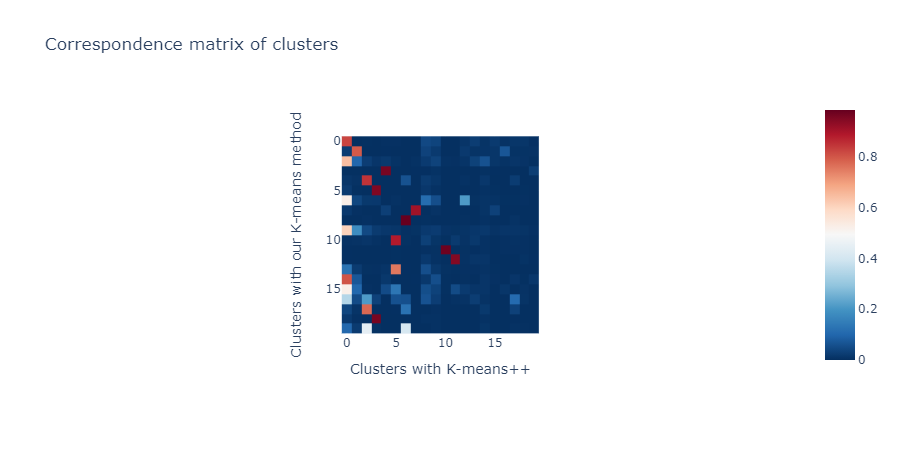

In [6]:
# Merge both clusters in one data frame
cluster_comp = pd.concat([cluster_kpp, cluster], axis = 1)
cluster_comp.columns = ['cluster_k_means_plus_plus', 'cluster_our_k_means']
# Re-order each cluster to gmake both methods comparables by the size of each cluster
clus_kpp = cluster_comp.cluster_k_means_plus_plus.value_counts().reset_index().reset_index().drop(['cluster_k_means_plus_plus'], axis=1)
clus_kpp.columns = ['cluster_k_means_plus_plus_new', 'cluster_k_means_plus_plus']
clus = cluster_comp.cluster_our_k_means.value_counts().reset_index().reset_index().drop(['cluster_our_k_means'], axis=1)
clus.columns = ['cluster_our_k_means_new', 'cluster_our_k_means']
cluster_comp = pd.merge(cluster_comp,clus_kpp, on='cluster_k_means_plus_plus')
cluster_comp = pd.merge(cluster_comp,clus, on='cluster_our_k_means')

# Plot heat map
a = pd.crosstab(cluster_comp.cluster_k_means_plus_plus_new, cluster_comp.cluster_our_k_means_new)
a = a.div(a.sum(axis=1), axis=0).to_numpy()
# a.to_clipboard(sep = '\t')

fig = px.imshow(a, color_continuous_scale='RdBu_r', title = "Correspondence matrix of clusters", labels={'y':'Clusters with our K-means method','x':'Clusters with K-means++'})
fig.show()

As we can see, the results of both algorithms are pretty different. We were expecting to have the main diagonal of the correspondence matrix with the highest percentage values, in case that both methods were the same. But, as we can see, that did not happen. Nevertheless, some clusters have the correspondence percentage close to 100% (the clusters with a colour similar to the dark red). The latter occurred for almost 8 groups. That could mean that those clusters are pretty similar.

Finally, we can compare the inertia of each approach.

In [8]:
print("Inertia of our K-means algorithm:", inertia.iloc[0,0])
print("Inertia of K-means++ algorithm:", inertia_kpp.iloc[0,0])

Inertia of our K-means algorithm: 319267.0804204261
Inertia of K-means++ algorithm: 318452.3


The inertia measures how well-concentrated (homogeneous) are the groups found. We expect that the inertia being the lowest possible. That is the way the K-means++ algorithm seems to be doing a better job to find clusters of the reviews. The previous result was expected since the initial clusters are generated considering the probability of remoteness in each cluster initialization. The latter means that K-mean++ generate better initial centroids that lead to better inertia.

## 3. Analyse the obtained clusters

To analyze the cluster that we got, we will stack the groups obtained with our algorithm to the complete data.

In [6]:
# Add cluster to the data
dataset_reduced['cluster'] = cluster.iloc[:,0]

### Identify the kind of products in the cluster

In [7]:
start_time = time.time()

dataset_reduced['reviews'] = dataset_reduced['Text_prep'].apply(our_functions.avoid_words)
# print(dataset_reduced['Text_prep'][0:3].apply(avoid_words))
    
# Export data set to load it in case that any process crashes
dataset_reduced.to_csv('data/reviews_mod2.csv', index = False, sep="|")
print("--- %s seconds ---" % (time.time() - start_time))

--- 2185.6814217567444 seconds ---


In [10]:
start_time = time.time()

dataset_reduced['reviews2'] = [' '.join(map(str, l)) for l in dataset_reduced['reviews']]
print("--- %s seconds ---" % (time.time() - start_time))

--- 2.4959070682525635 seconds ---


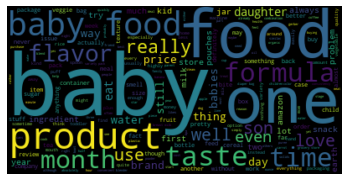

--- 2.7596240043640137 seconds ---


In [18]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 0]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Baby food, pouches, water

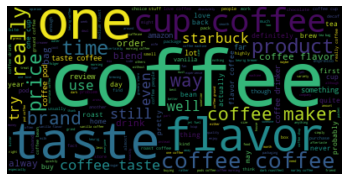

--- 4.475525379180908 seconds ---


In [19]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 1]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cofee, bean, , cofee pod

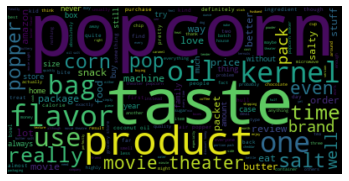

--- 1.784757137298584 seconds ---


In [20]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 2]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Popcorn, oil, bags, snack, popper

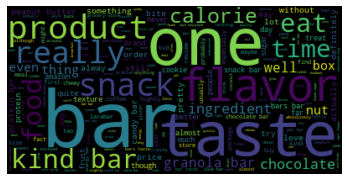

--- 2.8886847496032715 seconds ---


In [21]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 3]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Snacks, protein bar, granola bar

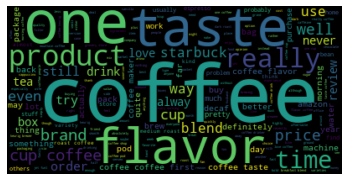

--- 5.253571271896362 seconds ---


In [22]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 4]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cofee, tea, boxes, pods, cups

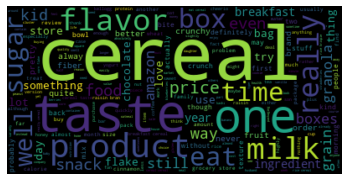

--- 2.339247465133667 seconds ---


In [23]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 5]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cereal, milk, snacks, sugar, breakfast

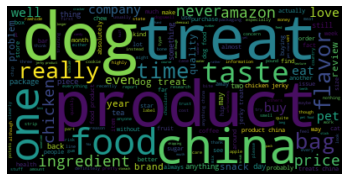

--- 1.4820473194122314 seconds ---


In [24]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 6]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Hot dogs, chinese food, chicken

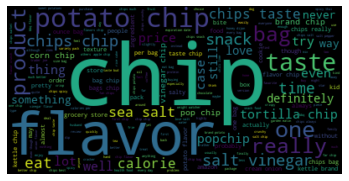

--- 2.50282621383667 seconds ---


In [25]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 7]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Chips, popchips, sea salt, potatoes

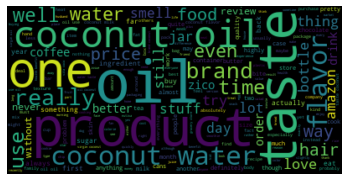

--- 2.7620956897735596 seconds ---


In [26]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 8]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Coconut, water, oil

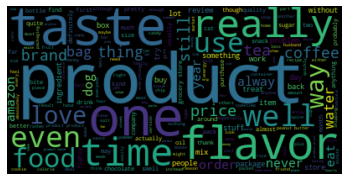

--- 8.18230938911438 seconds ---


In [27]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 9]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Hot dogs, water, oil

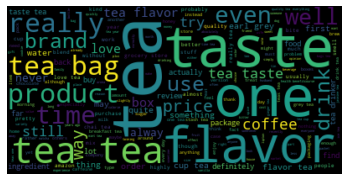

--- 5.975057363510132 seconds ---


In [28]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 10]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Tea bags, cofee, drinks

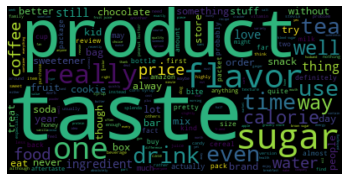

--- 4.216994762420654 seconds ---


In [29]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 11]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Sugar, snacks, chocolate

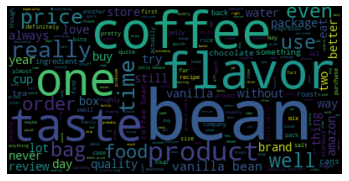

--- 1.9188692569732666 seconds ---


In [30]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 12]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cofee, beans, water

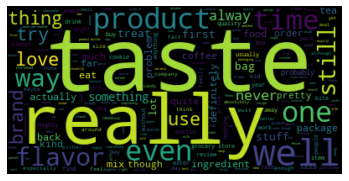

--- 33.15063214302063 seconds ---


In [31]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 13]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In this group we can not really identify products that appear frequently in the reviews.

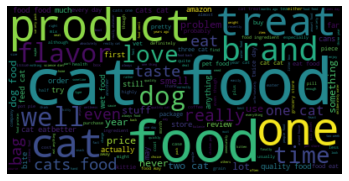

--- 4.418419599533081 seconds ---


In [32]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 14]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cat food, dog foot

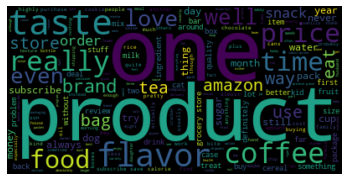

--- 1.9291906356811523 seconds ---


In [33]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 15]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cofee, Tea, bags, snacks

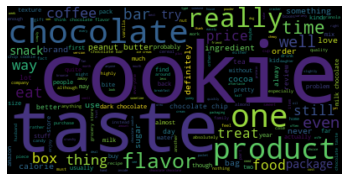

--- 4.545947313308716 seconds ---


In [34]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 16]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Cookies, Chocolate, snack

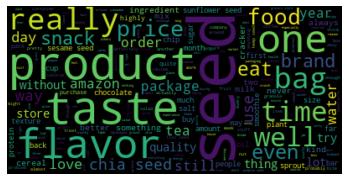

--- 1.4803175926208496 seconds ---


In [35]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 17]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Seeds, bags, snacks, chia seed, water

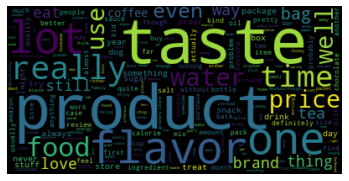

--- 3.837414264678955 seconds ---


In [36]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 18]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Water, Coffee

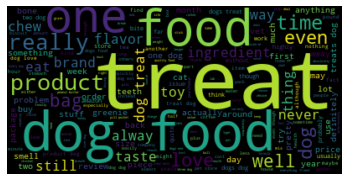

--- 6.421847343444824 seconds ---


In [37]:
start_time = time.time()
wordcloud0 = WordCloud().generate(' '.join(dataset_reduced[dataset_reduced.cluster == 19]['reviews2']))
# wordcloud2 = WordCloud().generate(' '.join(dataset_reduced['reviews']))
# make figure to plot
plt.figure()
# plot words
plt.imshow(wordcloud0, interpolation="bilinear")
# remove axes
plt.axis("off")
# show the result
plt.show()
print("--- %s seconds ---" % (time.time() - start_time))

In the previous cluster we can identify relevant products like: Dog food, bags, dog treat

### Provide the number of product in each cluster

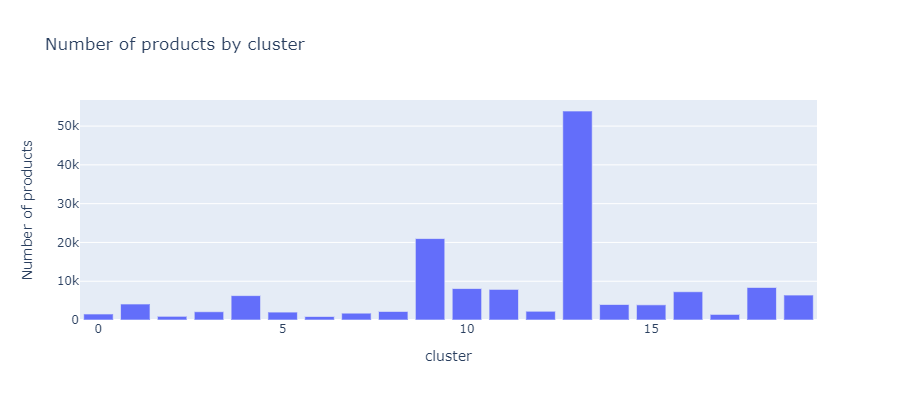

In [38]:
# Drop duplicates by product and cluster and count number of products by cluster
aux = dataset_reduced.drop_duplicates(subset = ['ProductId', 'cluster'], keep = 'first').groupby('cluster').ProductId.count().reset_index().rename(columns={'ProductId':'my_count'})
fig = px.bar(aux, x="cluster", y="my_count", width=800, height=400,  title="Number of products by cluster",labels={"my_count": "Number of products"})
fig.show()

From the previous chart we see that the cluster that has the higher number of products is the number 2. On the other hand, the cluster with less quantity of products is the number 22.

### Compute the reviews' score distribution in each cluster

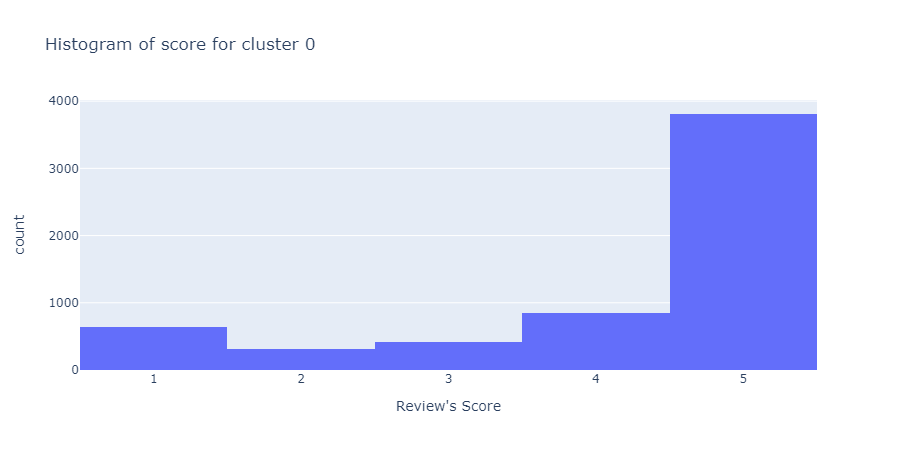

In [39]:
# Plot histogram for score per cluster
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 0], x="Score", title='Histogram of score for cluster 0', labels={'Score':'Review\'s Score'})
fig.show()

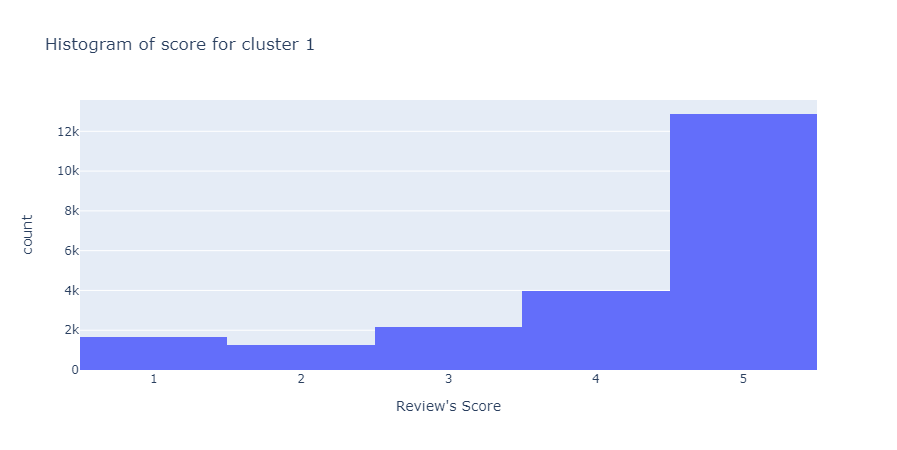

In [40]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 1], x="Score", title='Histogram of score for cluster 1', labels={'Score':'Review\'s Score'})
fig.show()

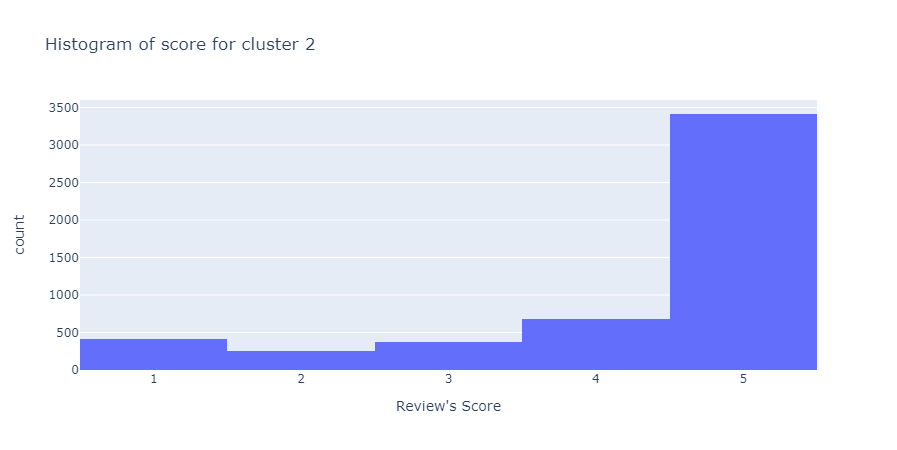

In [41]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 2], x="Score", title='Histogram of score for cluster 2', labels={'Score':'Review\'s Score'})
fig.show()

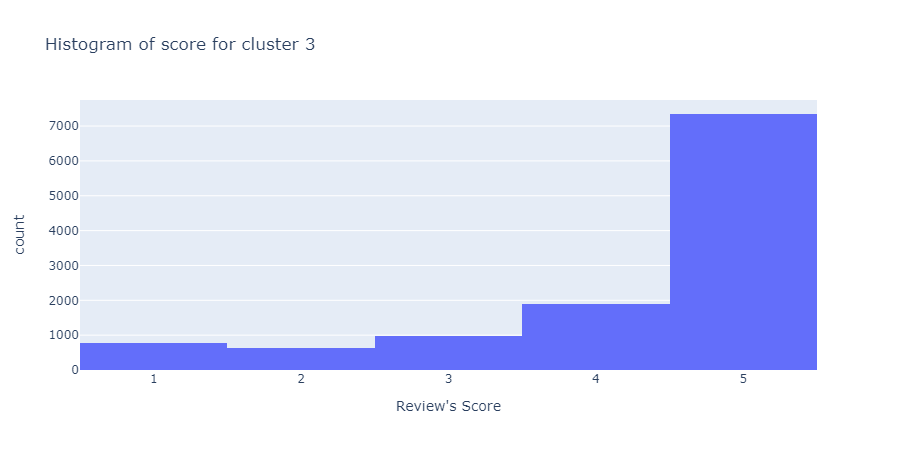

In [42]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 3], x="Score", title='Histogram of score for cluster 3', labels={'Score':'Review\'s Score'})
fig.show()

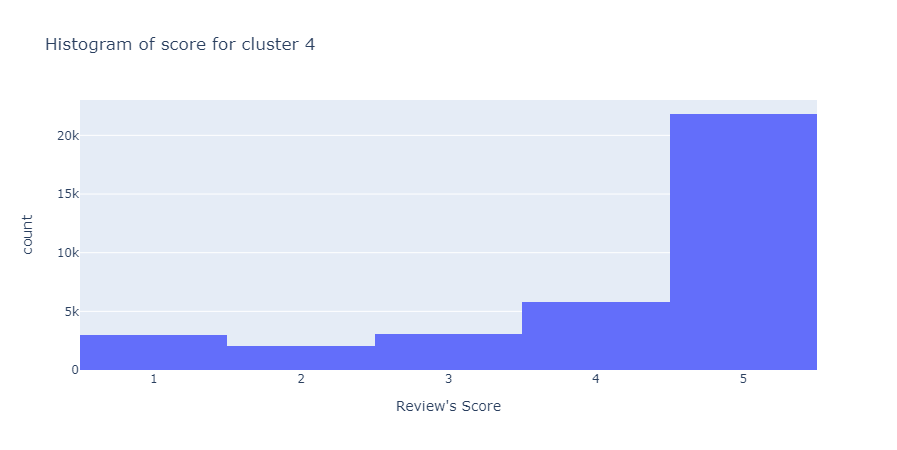

In [43]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 4], x="Score", title='Histogram of score for cluster 4', labels={'Score':'Review\'s Score'})
fig.show()

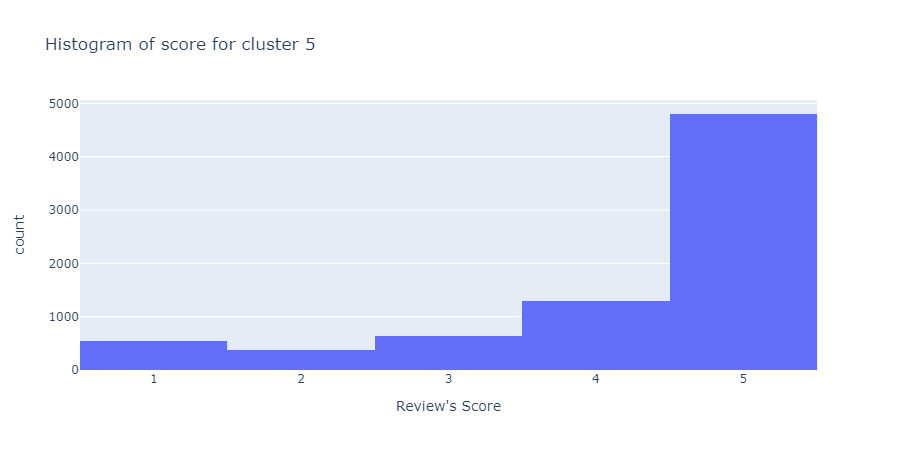

In [44]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 5], x="Score", title='Histogram of score for cluster 5', labels={'Score':'Review\'s Score'})
fig.show()

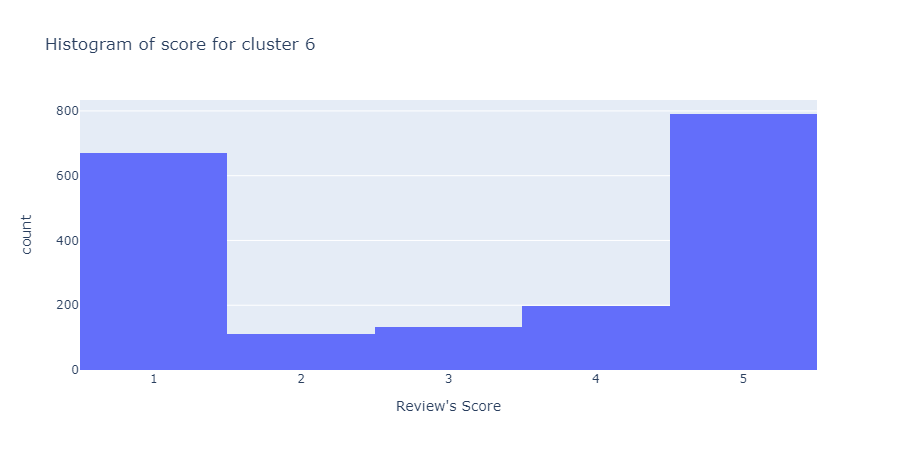

In [45]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 6], x="Score", title='Histogram of score for cluster 6', labels={'Score':'Review\'s Score'})
fig.show()

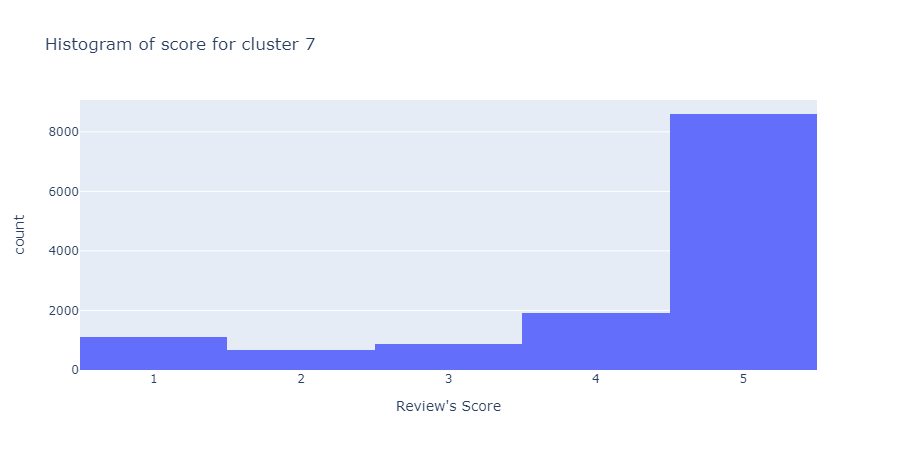

In [46]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 7], x="Score", title='Histogram of score for cluster 7', labels={'Score':'Review\'s Score'})
fig.show()

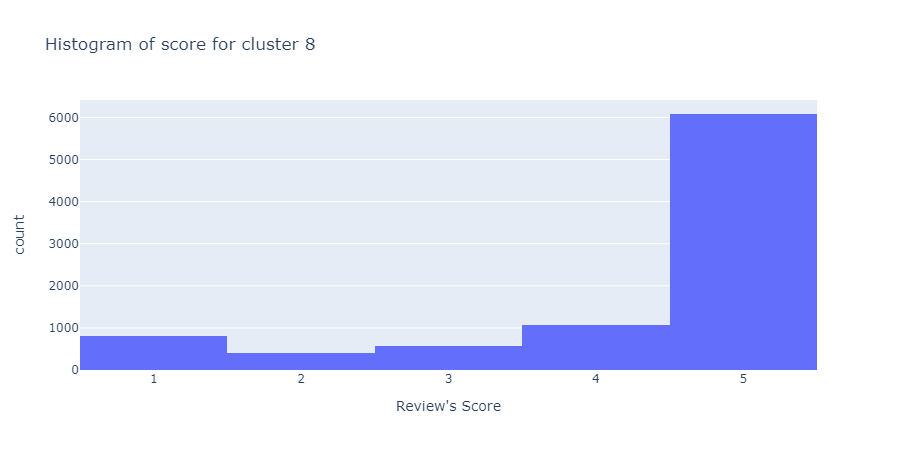

In [47]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 8], x="Score", title='Histogram of score for cluster 8', labels={'Score':'Review\'s Score'})
fig.show()

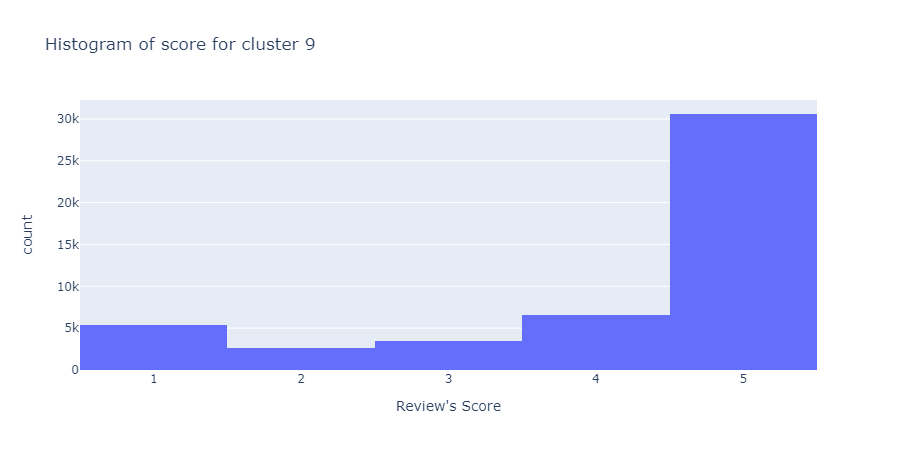

In [48]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 9], x="Score", title='Histogram of score for cluster 9', labels={'Score':'Review\'s Score'})
fig.show()

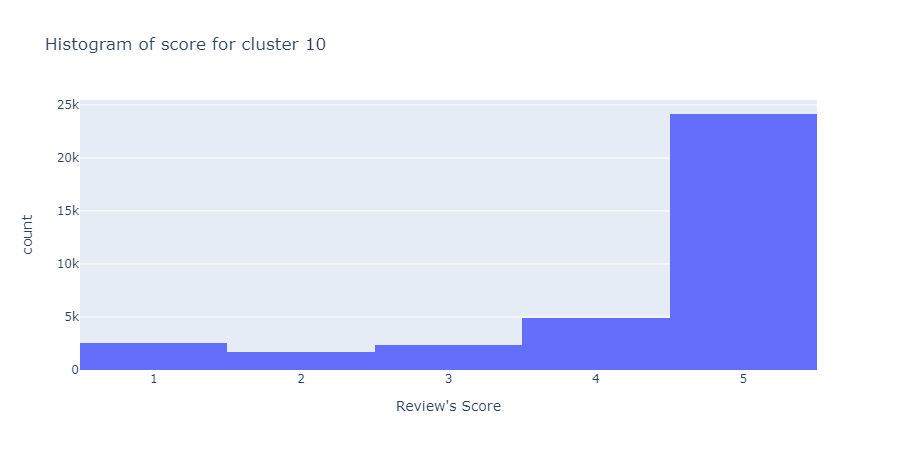

In [49]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 10], x="Score", title='Histogram of score for cluster 10', labels={'Score':'Review\'s Score'})
fig.show()

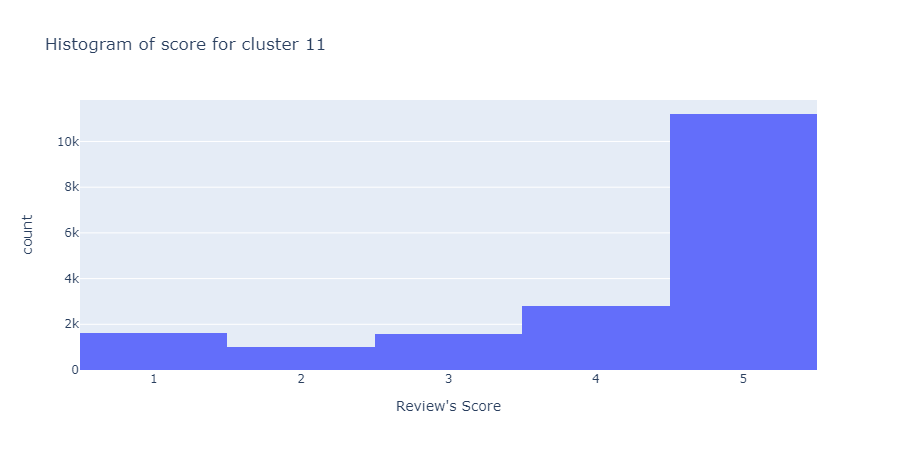

In [50]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 11], x="Score", title='Histogram of score for cluster 11', labels={'Score':'Review\'s Score'})
fig.show()

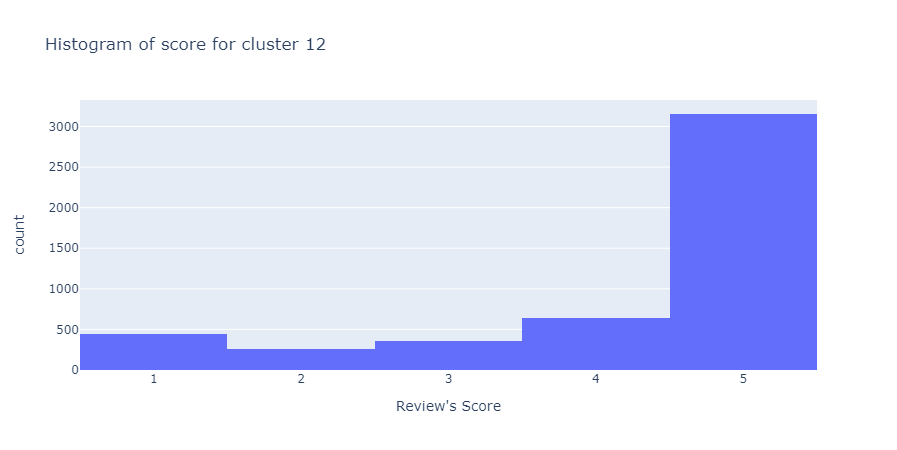

In [51]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 12], x="Score", title='Histogram of score for cluster 12', labels={'Score':'Review\'s Score'})
fig.show()

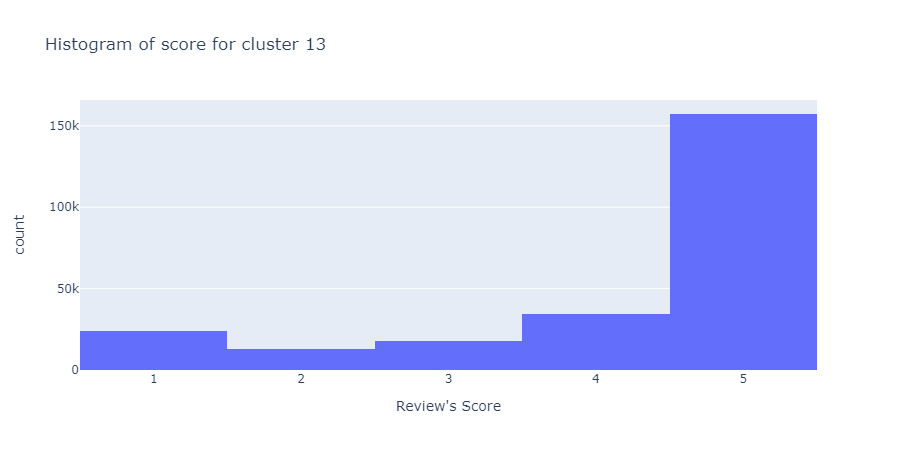

In [52]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 13], x="Score", title='Histogram of score for cluster 13', labels={'Score':'Review\'s Score'})
fig.show()

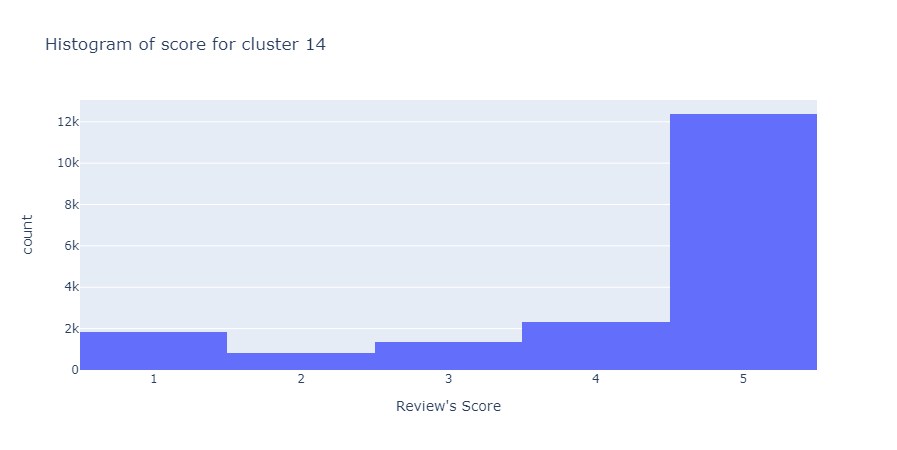

In [53]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 14], x="Score", title='Histogram of score for cluster 14', labels={'Score':'Review\'s Score'})
fig.show()

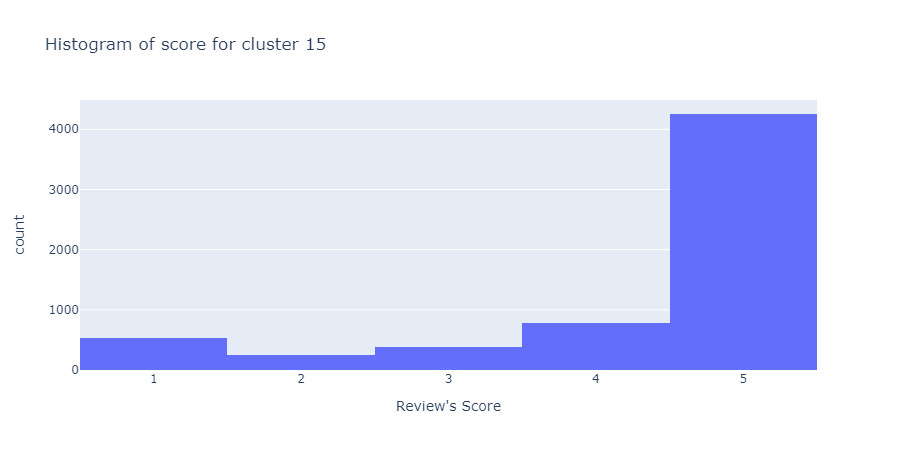

In [54]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 15], x="Score", title='Histogram of score for cluster 15', labels={'Score':'Review\'s Score'})
fig.show()

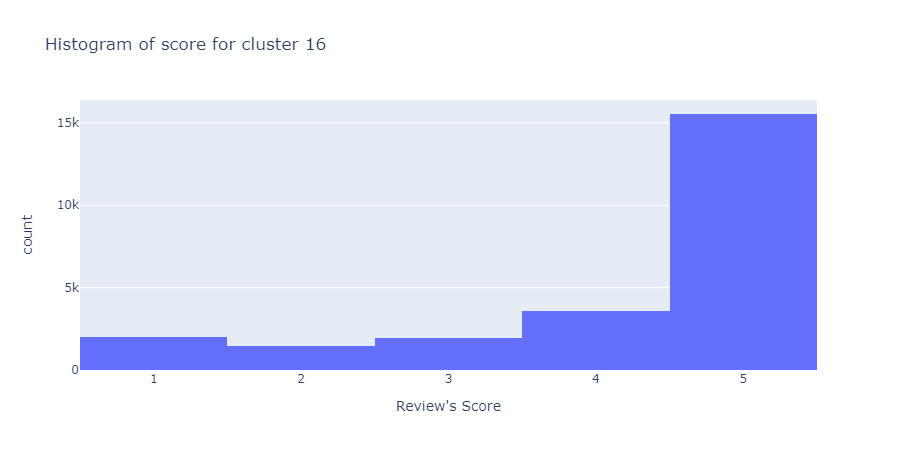

In [55]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 16], x="Score", title='Histogram of score for cluster 16', labels={'Score':'Review\'s Score'})
fig.show()

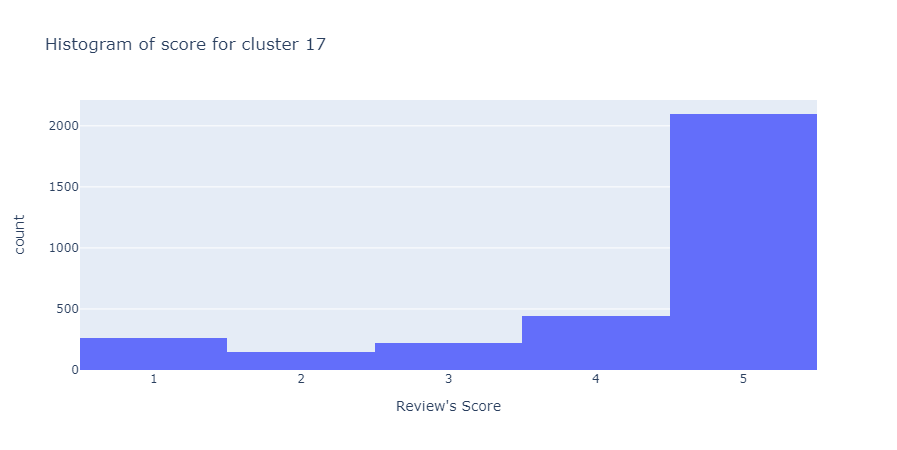

In [56]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 17], x="Score", title='Histogram of score for cluster 17', labels={'Score':'Review\'s Score'})
fig.show()

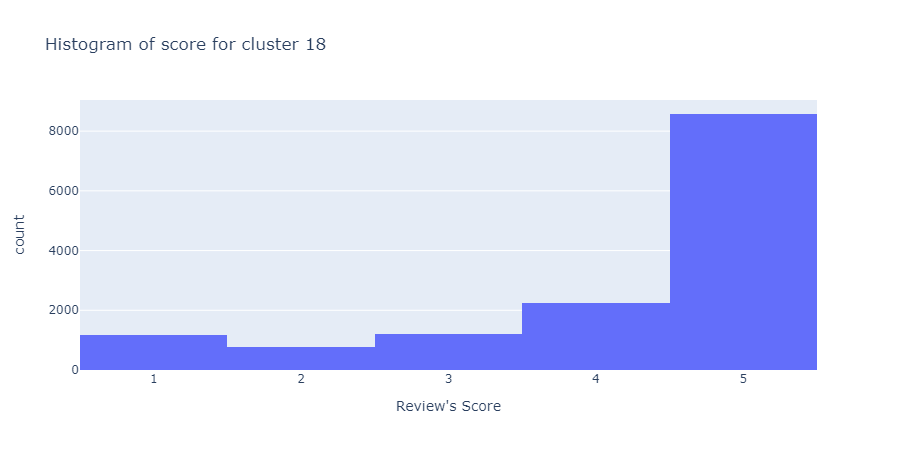

In [57]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 18], x="Score", title='Histogram of score for cluster 18', labels={'Score':'Review\'s Score'})
fig.show()

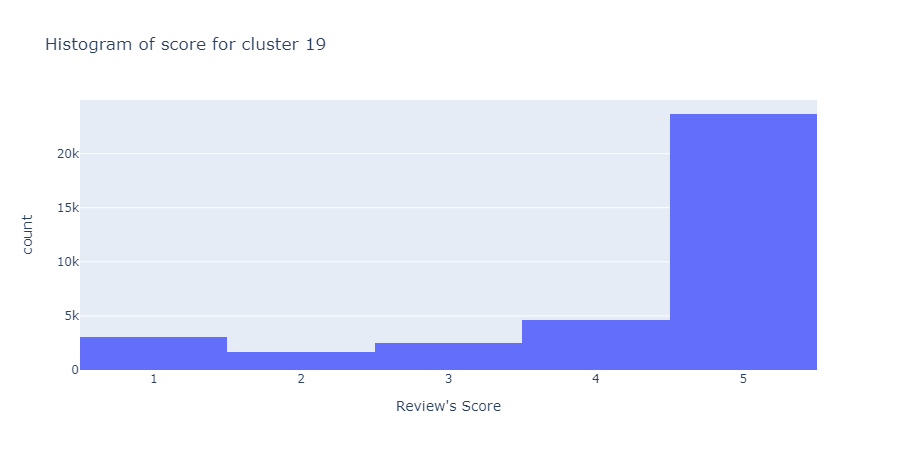

In [58]:
fig = px.histogram(dataset_reduced[dataset_reduced.cluster == 19], x="Score", title='Histogram of score for cluster 19', labels={'Score':'Review\'s Score'})
fig.show()

Regarding the distribution of the review's score, we can see that it is similar along with all the clusters. In all of them, score 5 is the one that appears the most. Besides, score 2 is the one that appears less. The only cluster that seems to change the score distribution is number 6, where the proportion of reviews with score 1 is higher than the other clusters.

Next, we need to check if the mean of the scores obtained in each of the clusters is statistically significant. To perform it, we decided to do an ANOVA test where we took the Score as the response variable and the cluster an explanatory variable to check if the significance of the cluster variable is relevant, meaning that the difference of the means in each cluster is different, statistically speaking.

In [59]:
# Ordinary Least Squares (OLS) model
model = ols('Score ~ C(cluster)', data=dataset_reduced).fit()
anova_table = sm.stats.anova_lm(model, typ = 2)
anova_table

,sum_sq,df,F,PR(>F)
C(cluster),3197.912475,19.0,98.330462,0.0
Residual,972954.907995,568418.0,NaN,NaN


With the previous result we got that a significance level of 5%, we reject the null hypothesis. That means that the average score is indeed different for at least one of the clusters that we have constructed.

Text(0.5, 1.0, 'Box plot for Score in each cluster')

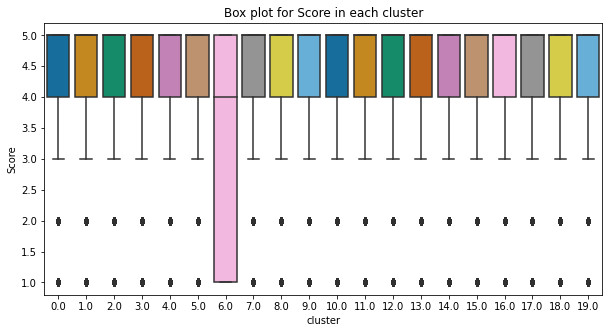

In [60]:
fig = pyplot.subplots(figsize = (10,5))
sns.boxplot(y='Score', x='cluster', data=dataset_reduced, palette="colorblind").set_title("Box plot for Score in each cluster")

Besides, we created a Box Plot of the score for each cluster. As we can see, both clusters 9 and 20 have a different distribution with respect to the other clusters. That is why the ANOVA test suggested that there are significant differences in the mean when varying the groups.

Once we have got our analysis, we need to test if the assumptions of the ANOVA test are plausible or not to be sure that the conclusions obtained before are valid. The first assumption is that the residuals of the model are Gaussian. To check it out, we use the Shapiro-Wilks test of Normality and also a QQ-Plot.

In [61]:
# Shapiro-Wilks test for Normality (Gaussianity)
stats.shapiro(model.resid)

C:\Users\Daniel_Jimenez\anaconda3\envs\ADM\lib\site-packages\scipy\stats\morestats.py:1681: UserWarning:

p-value may not be accurate for N > 5000.



ShapiroResult(statistic=0.6855030655860901, pvalue=0.0)

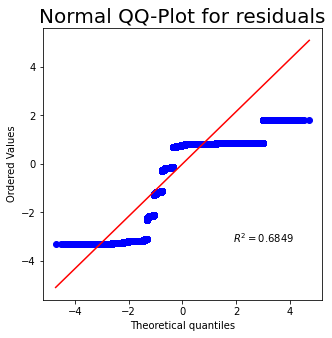

In [62]:
fig = plt.figure(figsize= (5, 5))
ax = fig.add_subplot(111)

normality_plot, stat = stats.probplot(model.resid, plot= plt, rvalue= True)
ax.set_title("Normal QQ-Plot for residuals", fontsize= 20)
ax.set

plt.show()

Taking the P-value of the Shapiro test (ar 5% of significance) and observing the QQ-Plot, we can conclude that the residuals are not Normal and that the Gaussianity assumption is not satisfied.

Another assumption is that the variance of the Score across the cluster is the same. To check if it holds, we use the Levene test.

In [63]:
stats.levene(dataset_reduced['Score'][dataset_reduced['cluster'] == 0],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 1],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 2],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 3],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 4],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 5],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 6],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 7],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 8],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 9],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 10],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 11],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 12],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 13],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 14],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 15],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 16],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 17],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 18],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 19])

LeveneResult(statistic=80.37623901721527, pvalue=1.78327077525e-312)

Then with a significance level of 5%, we conclude that the variance of the score inside each cluster is not the same. That means that the constant variance assumption is not plausible.

Then, as a consequence of the previous analysis, the results obtained by the ANOVA are not trustworthy. 

Then, to solve that issue, we proposed to use a non-parametrical alternative to ANOVA that is the Kruskal-Wallis test to figure out if the median score is statistically different in each cluster.

In [64]:
#Perform Kruskal-Wallis for score
fvalue, pvalue =stats.kruskal(dataset_reduced['Score'][dataset_reduced['cluster'] == 0],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 1],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 2],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 3],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 4],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 5],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 6],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 7],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 8],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 9],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 10],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 11],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 12],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 13],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 14],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 15],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 16],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 17],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 18],
             dataset_reduced['Score'][dataset_reduced['cluster'] == 19])

print("Kruskall-Wllis test: F-value",fvalue,"P-value", pvalue)

Kruskall-Wllis test: F-value 1618.655787949767 P-value 0.0


Again, with the previous result we got that a significance level of 5%, we reject the null hypothesis. That means that the median score is indeed different for at least one of the clusters that we have constructed. But, this time, we are sure about the consistency of the results since the test is non-parametrical, and we don't have anything else to check (no hard assumptions).

### Get the number of unique users writing reviews in each cluster

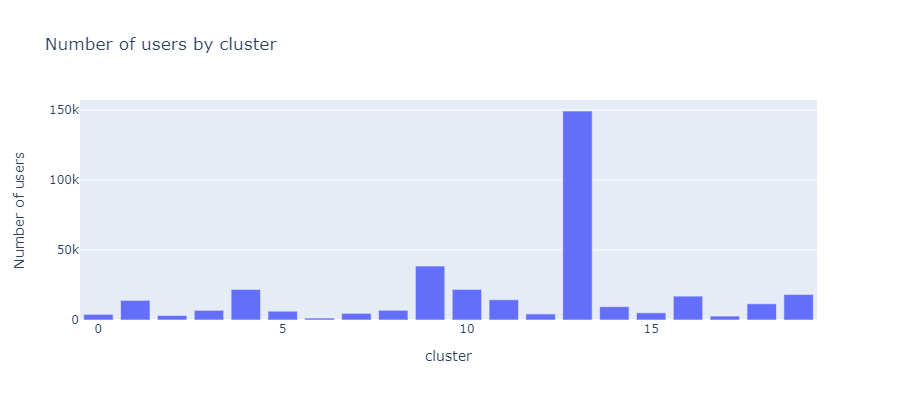

In [65]:
# Drop duplicates by product and cluster and count number of products by cluster
aux = dataset_reduced.drop_duplicates(subset = ['UserId', 'cluster'], keep = 'first').groupby('cluster').UserId.count().reset_index().rename(columns={'UserId':'my_count'})
fig = px.bar(aux, x="cluster", y="my_count", width=800, height=400,  title="Number of users by cluster",labels={"my_count": "Number of users"})
fig.show()

As shown in the previous ilustration, the cluster that has the higher number of users is the number 2. Also, we can conclude that the cluster 22 has the lowest quantity of users writting reviews among the clusters.

# 3. Algorithmic question


<br>Here we want to sort an array with n numbers. We are going to use an algorithm called Counting sort. As stated in the question; we assume that the numbers are integers. We also assume that numbers are nonnegative, and small integers. If n is not small enough it is better to use Radix sort which uses counting sort as a subroutine to sort an array of integer numbers.

We assume that each of the n input elements in input list has a key value ranging from: $s = min$ {$ A[1], ..., A[n]$} to $b = max$ {$A[1], ..., A[n]$}.
<br> So we have 3 lists here: first one is the input list $A$. The second one is $C$, which we use as a temporary memory, and the last one is our output $S$. $A$ and $S$ are in size $n$ and $C$ is in size $r+1$ ($r = b - s$).

1. First of all, we need to find the Maximum and Minimum element in list A;
<br>s = b = $A[0]$
<br>For $i$ in range$(n)$:
	<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;if $A[i] < s:$  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$s = A[i]$
	<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;if $A[i] > b:$  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$b = A[i]$
<br>$r = b - s$

<br>*Time complexity: $O(n)$

2. Create an temporary empty list $C$ of the size $r+1$ containing zeros;<br>
$C=[]$
<br>For $j$ in range$(s,b+1)$:
<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$C[j] = 0$

*Time complexity: $O(r)$

3. Iterate through the input list and count the occurrence of each key value. For each element $(A[i])$, we go to the specific index in $C$ which it's key value is $(A[i])$, and increase the value of $C[A[i]]$ by one;
<br>For $i$ in range$(n)$:
<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$C[A[i]] = C[A[i]] + 1$

*Time complexity: $O(n)$

4. We modify $C$ and add each number to the right of it accumulatively. So, $C[j]$ includes the number of elements that are less than or equal to it. It allow us to determine in which index of our output we must put each element;
<br>For $j$ in range$(s,b+1)$:
<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$C[j] = C[j] + C[j-1]$

*Time complexity: $O(r)$

5. We start at the last element of A, check the value of $A[i]$ and go to go to $C[A[i]]$ and write the value of the element at $A[i]$ to $S[C[A[i]]]$, and decrease the value of $C[A[i]]$ by one;
<br>For $i$ in range$(n-1,-1,-1)$: 
	<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$S[C[A[i]]] = A[i]$
	<br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;$C[A[i]] = C[A[i]] - 1 $

*Time complexity: $O(n)$

#### We have 5 loops with the running time of $O(n+r+n+r+n)$ So the overall time complexity is $O(n+r)$.